<a href="https://colab.research.google.com/github/preeti9734/Python/blob/master/Automating_Crypto_Website_API_Pull.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [14]:
from requests import Request, Session
from requests.exceptions import ConnectionError, Timeout, TooManyRedirects
import json

url = 'https://pro-api.coinmarketcap.com/v1/cryptocurrency/listings/latest'
parameters = {
  'start':'1',
  'limit':'5000',
  'convert':'USD'
}
headers = {
  'Accepts': 'application/json',
  'X-CMC_PRO_API_KEY': 'd85e3756-313e-469f-8e8b-fddc881676bb',
}

session = Session()
session.headers.update(headers)

try:
  response = session.get(url, params=parameters)
  data = json.loads(response.text)
  print(data)
except (ConnectionError, Timeout, TooManyRedirects) as e:
  print(e)

{'status': {'timestamp': '2024-07-04T09:58:32.372Z', 'error_code': 0, 'error_message': None, 'elapsed': 161, 'credit_count': 25, 'notice': None, 'total_count': 10000}, 'data': [{'id': 1, 'name': 'Bitcoin', 'symbol': 'BTC', 'slug': 'bitcoin', 'num_market_pairs': 11591, 'date_added': '2010-07-13T00:00:00.000Z', 'tags': ['mineable', 'pow', 'sha-256', 'store-of-value', 'state-channel', 'coinbase-ventures-portfolio', 'three-arrows-capital-portfolio', 'polychain-capital-portfolio', 'binance-labs-portfolio', 'blockchain-capital-portfolio', 'boostvc-portfolio', 'cms-holdings-portfolio', 'dcg-portfolio', 'dragonfly-capital-portfolio', 'electric-capital-portfolio', 'fabric-ventures-portfolio', 'framework-ventures-portfolio', 'galaxy-digital-portfolio', 'huobi-capital-portfolio', 'alameda-research-portfolio', 'a16z-portfolio', '1confirmation-portfolio', 'winklevoss-capital-portfolio', 'usv-portfolio', 'placeholder-ventures-portfolio', 'pantera-capital-portfolio', 'multicoin-capital-portfolio', 'p

In [15]:
type(data)

dict

In [17]:
import pandas as pd


#This allows you to see all the columns, not just like 15
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)


In [18]:
df = pd.json_normalize(data['data'])
df['timestamp'] = pd.to_datetime('now')
df

,id,name,symbol,slug,num_market_pairs,date_added,tags,max_supply,circulating_supply,total_supply,infinite_supply,platform,cmc_rank,self_reported_circulating_supply,self_reported_market_cap,tvl_ratio,last_updated,quote.USD.price,quote.USD.volume_24h,quote.USD.volume_change_24h,quote.USD.percent_change_1h,quote.USD.percent_change_24h,quote.USD.percent_change_7d,quote.USD.percent_change_30d,quote.USD.percent_change_60d,quote.USD.percent_change_90d,quote.USD.market_cap,quote.USD.market_cap_dominance,quote.USD.fully_diluted_market_cap,quote.USD.tvl,quote.USD.last_updated,platform.id,platform.name,platform.symbol,platform.slug,platform.token_address,timestamp
0,1,Bitcoin,BTC,bitcoin,11591,2010-07-13T00:00:00.000Z,"[mineable, pow, sha-256, store-of-value, state...",2.100000e+07,1.971943e+07,19719431,False,NaN,1,NaN,NaN,NaN,2024-07-04T09:56:00.000Z,5.768545e+04,3.847897e+10,6.425510e+01,2.380314e-02,-4.672335,-5.771831,-15.907543,-9.465966e+00,-1.358101e+01,1.137524e+12,53.3239,1.211394e+12,NaN,2024-07-04T09:56:00.000Z,NaN,NaN,NaN,NaN,NaN,2024-07-04 10:04:35.456040
1,1027,Ethereum,ETH,ethereum,9117,2015-08-07T00:00:00.000Z,"[pos, smart-contracts, ethereum-ecosystem, coi...",NaN,1.201951e+08,120195136.343021,True,NaN,2,NaN,NaN,NaN,2024-07-04T09:55:00.000Z,3.160182e+03,2.006345e+10,7.879670e+01,1.814901e-01,-5.329452,-6.774445,-15.641166,4.185690e-01,-3.509707e+00,3.798385e+11,17.7973,3.798385e+11,NaN,2024-07-04T09:55:00.000Z,NaN,NaN,NaN,NaN,NaN,2024-07-04 10:04:35.456040
2,825,Tether USDt,USDT,tether,90873,2015-02-25T00:00:00.000Z,"[stablecoin, asset-backed-stablecoin, avalanch...",NaN,1.124849e+11,116076856617.381027,True,NaN,3,NaN,NaN,NaN,2024-07-04T09:55:00.000Z,9.990174e-01,7.338696e+10,6.370070e+01,-1.214559e-02,0.041713,-0.005330,-0.066678,-1.145979e-01,-9.559410e-02,1.123743e+11,5.2627,1.159628e+11,NaN,2024-07-04T09:55:00.000Z,1027.0,Ethereum,ETH,ethereum,0xdac17f958d2ee523a2206206994597c13d831ec7,2024-07-04 10:04:35.456040
3,1839,BNB,BNB,bnb,2188,2017-07-25T00:00:00.000Z,"[marketplace, centralized-exchange, payments, ...",NaN,1.475830e+08,147582961.36433,False,NaN,4,NaN,NaN,NaN,2024-07-04T09:55:00.000Z,5.294532e+02,2.006393e+09,2.366190e+01,2.778763e-01,-6.474432,-7.695986,-15.341609,-9.885389e+00,-7.936541e+00,7.813827e+10,3.6604,7.813827e+10,NaN,2024-07-04T09:55:00.000Z,NaN,NaN,NaN,NaN,NaN,2024-07-04 10:04:35.456040
4,5426,Solana,SOL,solana,697,2020-04-10T00:00:00.000Z,"[pos, platform, solana-ecosystem, cms-holdings...",NaN,4.627688e+08,579372447.02782,True,NaN,5,NaN,NaN,NaN,2024-07-04T09:55:00.000Z,1.346320e+02,3.221737e+09,3.048620e+01,4.424601e-02,-7.983304,-2.321228,-18.166082,-7.688834e+00,-2.197705e+01,6.230351e+10,2.9203,7.800210e+10,NaN,2024-07-04T09:55:00.000Z,NaN,NaN,NaN,NaN,NaN,2024-07-04 10:04:35.456040
5,3408,USDC,USDC,usd-coin,20731,2018-10-08T00:00:00.000Z,"[medium-of-exchange, stablecoin, asset-backed-...",NaN,3.286047e+10,32860465948.949631,False,NaN,6,NaN,NaN,NaN,2024-07-04T09:55:00.000Z,9.999794e-01,7.063567e+09,4.701100e+01,-9.547680e-03,-0.006361,0.014436,0.000265,-9.313100e-04,1.748120e-03,3.285979e+10,1.5396,3.285979e+10,NaN,2024-07-04T09:55:00.000Z,1027.0,Ethereum,ETH,ethereum,0xa0b86991c6218b36c1d19d4a2e9eb0ce3606eb48,2024-07-04 10:04:35.456040
6,52,XRP,XRP,xrp,1346,2013-08-04T00:00:00.000Z,"[medium-of-exchange, enterprise-solutions, arr...",1.000000e+11,5.568833e+10,99987490594,False,NaN,7,NaN,NaN,NaN,2024-07-04T09:56:00.000Z,4.518273e-01,1.557855e+09,6.618160e+01,-1.683760e-02,-6.638851,-3.838723,-13.171491,-1.471878e+01,-2.161012e+01,2.516151e+10,1.1793,4.518273e+10,NaN,2024-07-04T09:56:00.000Z,NaN,NaN,NaN,NaN,NaN,2024-07-04 10:04:35.456040
7,11419,Toncoin,TON,toncoin,449,2021-08-26T13:40:22.000Z,"[pos, layer-1, ftx-bankruptcy-estate, dwf-labs...",NaN,2.460401e+09,5108504370.151813,True,NaN,8,3.414167e+09,2.458222e+10,NaN,2024-07-04T09:55:00.000Z,7.200066e+00,5.146833e+08,6.406770e+01,-6.091429e-01,-8.854703,-5.719551,4.511461,2.517018e+01,3.900395e+01,1.771505e+10,0.8304,3.678157e+10,NaN,2024-07-0

In [23]:
def api_runner():
    global df
    url = 'https://pro-api.coinmarketcap.com/v1/cryptocurrency/listings/latest'
    #Original Sandbox Environment: 'https://sandbox-api.coinmarketcap.com/v1/cryptocurrency/listings/latest'
    parameters = {
      'start':'1',
      'limit':'15',
      'convert':'USD'
    }
    headers = {
      'Accepts': 'application/json',
      'X-CMC_PRO_API_KEY': 'd85e3756-313e-469f-8e8b-fddc881676bb',
    }

    session = Session()
    session.headers.update(headers)

    try:
      response = session.get(url, params=parameters)
      data = json.loads(response.text)
      #print(data)
    except (ConnectionError, Timeout, TooManyRedirects) as e:
      print(e)
#NOTE:
# I had to go in and put "jupyter notebook --NotebookApp.iopub_data_rate_limit=1e10"
# Into the Anaconda Prompt to change this to allow to pull data

    # Use this if you just want to keep it in a dataframe
    df2 = pd.json_normalize(data['data'])
    df2['Timestamp'] = pd.to_datetime('now')
    df_append = pd.DataFrame(df2)
    df = pd.concat([df2,df_append])

In [24]:
import os
from time import time
from time import sleep

for i in range(333):
    api_runner()
    print('API Runner completed')
    sleep(60) #sleep for 1 minute
exit()

API Runner completed
API Runner completed
API Runner completed
API Runner completed
API Runner completed
API Runner completed
API Runner completed
API Runner completed
API Runner completed
API Runner completed
API Runner completed
API Runner completed
API Runner completed
API Runner completed
API Runner completed
API Runner completed


KeyboardInterrupt: 

In [25]:
df

,id,name,symbol,slug,num_market_pairs,date_added,tags,max_supply,circulating_supply,total_supply,infinite_supply,platform,cmc_rank,self_reported_circulating_supply,self_reported_market_cap,tvl_ratio,last_updated,quote.USD.price,quote.USD.volume_24h,quote.USD.volume_change_24h,quote.USD.percent_change_1h,quote.USD.percent_change_24h,quote.USD.percent_change_7d,quote.USD.percent_change_30d,quote.USD.percent_change_60d,quote.USD.percent_change_90d,quote.USD.market_cap,quote.USD.market_cap_dominance,quote.USD.fully_diluted_market_cap,quote.USD.tvl,quote.USD.last_updated,platform.id,platform.name,platform.symbol,platform.slug,platform.token_address,Timestamp
0,1,Bitcoin,BTC,bitcoin,11592,2010-07-13T00:00:00.000Z,"[mineable, pow, sha-256, store-of-value, state...",2.100000e+07,1.971944e+07,1.971944e+07,False,NaN,1,NaN,NaN,None,2024-07-04T10:30:00.000Z,57550.248600,3.815630e+10,59.5875,0.103889,-4.188151,-5.943280,-16.340098,-9.606729,-13.911904,1.134859e+12,53.4206,1.208555e+12,None,2024-07-04T10:30:00.000Z,NaN,NaN,NaN,NaN,NaN,2024-07-04 10:31:03.062890
1,1027,Ethereum,ETH,ethereum,9117,2015-08-07T00:00:00.000Z,"[pos, smart-contracts, ethereum-ecosystem, coi...",NaN,1.201951e+08,1.201951e+08,True,NaN,2,NaN,NaN,None,2024-07-04T10:29:00.000Z,3146.186757,1.972391e+10,67.8205,-0.223694,-4.840446,-7.498817,-16.284981,0.274007,-3.616787,3.781563e+11,17.8227,3.781563e+11,None,2024-07-04T10:29:00.000Z,NaN,NaN,NaN,NaN,NaN,2024-07-04 10:31:03.062890
2,825,Tether USDt,USDT,tether,90879,2015-02-25T00:00:00.000Z,"[stablecoin, asset-backed-stablecoin, avalanch...",NaN,1.124849e+11,1.160769e+11,True,NaN,3,NaN,NaN,None,2024-07-04T10:29:00.000Z,0.999119,7.272587e+10,58.8239,-0.001250,0.038031,0.020230,-0.059130,-0.109279,-0.095376,1.123858e+11,5.2966,1.159746e+11,None,2024-07-04T10:29:00.000Z,1027.0,Ethereum,ETH,ethereum,0xdac17f958d2ee523a2206206994597c13d831ec7,2024-07-04 10:31:03.062890
3,1839,BNB,BNB,bnb,2188,2017-07-25T00:00:00.000Z,"[marketplace, centralized-exchange, payments, ...",NaN,1.475830e+08,1.475830e+08,False,NaN,4,NaN,NaN,None,2024-07-04T10:29:00.000Z,525.213216,1.971079e+09,19.9699,-0.125994,-6.163336,-8.350512,-17.474506,-10.456264,-8.589353,7.751252e+10,3.6536,7.751252e+10,None,2024-07-04T10:29:00.000Z,NaN,NaN,NaN,NaN,NaN,2024-07-04 10:31:03.062890
4,5426,Solana,SOL,solana,697,2020-04-10T00:00:00.000Z,"[pos, platform, solana-ecosystem, cms-holdings...",NaN,4.627687e+08,5.793724e+08,True,NaN,5,NaN,NaN,None,2024-07-04T10:29:00.000Z,132.916991,3.169134e+09,24.0828,-0.913011,-8.003461,-4.096214,-19.605883,-8.715482,-22.184152,6.150983e+10,2.8984,7.700843e+10,None,2024-07-04T10:29:00.000Z,NaN,NaN,NaN,NaN,NaN,2024-07-04 10:31:03.062890
5,3408,USDC,USDC,usd-coin,20731,2018-10-08T00:00:00.000Z,"[medium-of-exchange, stablecoin, asset-backed-...",NaN,3.286410e+10,3.286410e+10,False,NaN,6,NaN,NaN,None,2024-07-04T10:29:00.000Z,0.999996,6.970309e+09,42.3767,-0.004523,-0.010915,0.028842,-0.001293,-0.012933,0.004321,3.286398e+10,1.5489,3.286398e+10,None,2024-07-04T10:29:00.000Z,1027.0,Ethereum,ETH,ethereum,0xa0b86991c6218b36c1d19d4a2e9eb0ce3606eb48,2024-07-04 10:31:03.062890
6,52,XRP,XRP,xrp,1346,2013-08-04T00:00:00.000Z,"[medium-of-exchange, enterprise-solutions, arr...",1.000000e+11,5.568833e+10,9.998749e+10,False,NaN,7,NaN,NaN,None,2024-07-04T10:30:00.000Z,0.449475,1.537466e+09,64.2800,-0.111675,-7.094138,-3.921013,-13.655283,-15.027572,-21.906447,2.503051e+10,1.1796,4.494750e+10,None,2024-07-04T10:30:00.000Z,NaN,NaN,NaN,NaN,NaN,2024-07-04 10:31:03.062890
7,11419,Toncoin,TON,toncoin,449,2021-08-26T13:40:22.000Z,"[pos, layer-1, ftx-bankruptcy-estate, dwf-labs...",NaN,2.460404e+09,5.108508e+09,True,NaN,8,3.414167e+09,2.460857e+10,None,2024-07-04T10:29:00.000Z,7.207783,4.966237e+08,54.7531,-0.133803,-8.075034,-5.813811,4.182542,25.653709,39.592958,1.773406e+10,0.8354,3.682102e+10,None,2024-07-04T10:29:00.000Z,NaN,NaN,NaN,NaN,NaN,2024-07-04 10:31:03.062890
8,74,Dogecoin,DOGE,dogecoin,1017,2013-12-15T00:00:00.000Z,"[mineable, pow, scrypt, medium-o

In [26]:
pd.set_option('display.float_format', lambda x: '%.5f' % x)

In [27]:
df

,id,name,symbol,slug,num_market_pairs,date_added,tags,max_supply,circulating_supply,total_supply,infinite_supply,platform,cmc_rank,self_reported_circulating_supply,self_reported_market_cap,tvl_ratio,last_updated,quote.USD.price,quote.USD.volume_24h,quote.USD.volume_change_24h,quote.USD.percent_change_1h,quote.USD.percent_change_24h,quote.USD.percent_change_7d,quote.USD.percent_change_30d,quote.USD.percent_change_60d,quote.USD.percent_change_90d,quote.USD.market_cap,quote.USD.market_cap_dominance,quote.USD.fully_diluted_market_cap,quote.USD.tvl,quote.USD.last_updated,platform.id,platform.name,platform.symbol,platform.slug,platform.token_address,Timestamp
0,1,Bitcoin,BTC,bitcoin,11592,2010-07-13T00:00:00.000Z,"[mineable, pow, sha-256, store-of-value, state...",21000000.00000,19719437.00000,19719437.00000,False,NaN,1,NaN,NaN,None,2024-07-04T10:30:00.000Z,57550.24860,38156297479.95592,59.58750,0.10389,-4.18815,-5.94328,-16.34010,-9.60673,-13.91190,1134858501606.01025,53.42060,1208555220604.22998,None,2024-07-04T10:30:00.000Z,NaN,NaN,NaN,NaN,NaN,2024-07-04 10:31:03.062890
1,1027,Ethereum,ETH,ethereum,9117,2015-08-07T00:00:00.000Z,"[pos, smart-contracts, ethereum-ecosystem, coi...",NaN,120195136.34302,120195136.34302,True,NaN,2,NaN,NaN,None,2024-07-04T10:29:00.000Z,3146.18676,19723905424.59448,67.82050,-0.22369,-4.84045,-7.49882,-16.28498,0.27401,-3.61679,378156346212.89252,17.82270,378156346212.89001,None,2024-07-04T10:29:00.000Z,NaN,NaN,NaN,NaN,NaN,2024-07-04 10:31:03.062890
2,825,Tether USDt,USDT,tether,90879,2015-02-25T00:00:00.000Z,"[stablecoin, asset-backed-stablecoin, avalanch...",NaN,112484875382.93484,116076856617.38103,True,NaN,3,NaN,NaN,None,2024-07-04T10:29:00.000Z,0.99912,72725874124.17229,58.82390,-0.00125,0.03803,0.02023,-0.05913,-0.10928,-0.09538,112385826320.60471,5.29660,115974644619.84000,None,2024-07-04T10:29:00.000Z,1027.00000,Ethereum,ETH,ethereum,0xdac17f958d2ee523a2206206994597c13d831ec7,2024-07-04 10:31:03.062890
3,1839,BNB,BNB,bnb,2188,2017-07-25T00:00:00.000Z,"[marketplace, centralized-exchange, payments, ...",NaN,147582959.85162,147582959.85162,False,NaN,4,NaN,NaN,None,2024-07-04T10:29:00.000Z,525.21322,1971079066.06864,19.96990,-0.12599,-6.16334,-8.35051,-17.47451,-10.45626,-8.58935,77512520926.09258,3.65360,77512520926.09000,None,2024-07-04T10:29:00.000Z,NaN,NaN,NaN,NaN,NaN,2024-07-04 10:31:03.062890
4,5426,Solana,SOL,solana,697,2020-04-10T00:00:00.000Z,"[pos, platform, solana-ecosystem, cms-holdings...",NaN,462768737.04753,579372381.13387,True,NaN,5,NaN,NaN,None,2024-07-04T10:29:00.000Z,132.91699,3169134070.74401,24.08280,-0.91301,-8.00346,-4.09621,-19.60588,-8.71548,-22.18415,61509828102.12586,2.89840,77008433625.03000,None,2024-07-04T10:29:00.000Z,NaN,NaN,NaN,NaN,NaN,2024-07-04 10:31:03.062890
5,3408,USDC,USDC,usd-coin,20731,2018-10-08T00:00:00.000Z,"[medium-of-exchange, stablecoin, asset-backed-...",NaN,32864100495.60976,32864100495.60976,False,NaN,6,NaN,NaN,None,2024-07-04T10:29:00.000Z,1.00000,6970308955.86131,42.37670,-0.00452,-0.01092,0.02884,-0.00129,-0.01293,0.00432,32863983310.69220,1.54890,32863983310.69000,None,2024-07-04T10:29:00.000Z,1027.00000,Ethereum,ETH,ethereum,0xa0b86991c6218b36c1d19d4a2e9eb0ce3606eb48,2024-07-04 10:31:03.062890
6,52,XRP,XRP,xrp,1346,2013-08-04T00:00:00.000Z,"[medium-of-exchange, enterprise-solutions, arr...",100000000000.00000,55688327582.00000,99987490594.00000,False,NaN,7,NaN,NaN,None,2024-07-04T10:30:00.000Z,0.44947,1537466265.19102,64.28000,-0.11168,-7.09414,-3.92101,-13.65528,-15.02757,-21.90645,25030509321.68284,1.17960,44947496914.55000,None,2024-07-04T10:30:00.000Z,NaN,NaN,NaN,NaN,NaN,2024-07-04 10:31:03.062890
7,11419,Toncoin,TON,toncoin,449,2021-08-26T13:40:22.000Z,"[pos, layer-1, ftx-bankruptcy-estate, dwf-labs...",NaN,2460404266.06110,5108507564.60511,True,NaN,8,3414166606.00000,24608573051.55840,None,2024-07-04T10:29:00.000Z,7.20778,496623737.45907,54.75310,-0.13380,-8.07503,-5.81381,4.18254,25.65371,39.59296,17734060784.06550,0.83540,36821015520.19000

In [28]:
df3 = df.groupby('name', sort=False)[['quote.USD.percent_change_1h','quote.USD.percent_change_24h','quote.USD.percent_change_7d','quote.USD.percent_change_30d','quote.USD.percent_change_60d','quote.USD.percent_change_90d']].mean()
df3

,quote.USD.percent_change_1h,quote.USD.percent_change_24h,quote.USD.percent_change_7d,quote.USD.percent_change_30d,quote.USD.percent_change_60d,quote.USD.percent_change_90d
name,,,,,,
Bitcoin,0.10389,-4.18815,-5.94328,-16.34010,-9.60673,-13.91190
Ethereum,-0.22369,-4.84045,-7.49882,-16.28498,0.27401,-3.61679
Tether USDt,-0.00125,0.03803,0.02023,-0.05913,-0.10928,-0.09538
BNB,-0.12599,-6.16334,-8.35051,-17.47451,-10.45626,-8.58935
Solana,-0.91301,-8.00346,-4.09621,-19.60588,-8.71548,-22.18415
USDC,-0.00452,-0.01092,0.02884,-0.00129,-0.01293,0.00432
XRP,-0.11168,-7.09414,-3.92101,-13.65528,-15.02757,-21.90645
Toncoin,-0.13380,-8.07503,-5.81381,4.18254,25.65371,39.59296
Dogecoin,-0.46775,-8.05640,-10.12291,-30.01848,-31.20562,-35.18836


In [29]:
df4 = df3.stack()
df4

name                                     
Bitcoin      quote.USD.percent_change_1h      0.10389
             quote.USD.percent_change_24h    -4.18815
             quote.USD.percent_change_7d     -5.94328
             quote.USD.percent_change_30d   -16.34010
             quote.USD.percent_change_60d    -9.60673
             quote.USD.percent_change_90d   -13.91190
Ethereum     quote.USD.percent_change_1h     -0.22369
             quote.USD.percent_change_24h    -4.84045
             quote.USD.percent_change_7d     -7.49882
             quote.USD.percent_change_30d   -16.28498
             quote.USD.percent_change_60d     0.27401
             quote.USD.percent_change_90d    -3.61679
Tether USDt  quote.USD.percent_change_1h     -0.00125
             quote.USD.percent_change_24h     0.03803
             quote.USD.percent_change_7d      0.02023
             quote.USD.percent_change_30d    -0.05913
             quote.USD.percent_change_60d    -0.10928
             quote.USD.percent_change_90

In [30]:
type(df4)

pandas.core.series.Series

In [31]:
df5 = df4.to_frame(name='values')
df5

values
name                                              
Bitcoin     quote.USD.percent_change_1h    0.10389
            quote.USD.percent_change_24h  -4.18815
            quote.USD.percent_change_7d   -5.94328
            quote.USD.percent_change_30d -16.34010
            quote.USD.percent_change_60d  -9.60673
            quote.USD.percent_change_90d -13.91190
Ethereum    quote.USD.percent_change_1h   -0.22369
            quote.USD.percent_change_24h  -4.84045
            quote.USD.percent_change_7d   -7.49882
            quote.USD.percent_change_30d -16.28498
            quote.USD.percent_change_60d   0.27401
            quote.USD.percent_change_90d  -3.61679
Tether USDt quote.USD.percent_change_1h   -0.00125
            quote.USD.percent_change_24h   0.03803
            quote.USD.percent_change_7d    0.02023
            quote.USD.percent_change_30d  -0.05913
            quote.USD.percent_change_60d  -0.10928
            quote.USD.percent_change_90d  -0.09538
BNB         quote.USD.percent_change_1h   -0.12599
            quote.USD.percent_change_24h  -6.16334
            quote.USD.percent_change_7d   -8.35051
            quote.USD.percent_change_30d -17.47451
            quote.USD.percent_change_60d -10.45626
            quote.USD.percent_change_90d  -8.58935
Solana      quote.USD.percent_change_1h   -0.91301
            quote.USD.percent_change_24h  -8.00346
            quote.USD.percent_change_7d   -4.09621
            quote.USD.percent_change_30d -19.60588
            quote.USD.percent_change_60d  -8.71548
            quote.USD.percent_change_90d -22.18415
USDC        quote.USD.percent_change_1h   -0.00452
            quote.USD.percent_change_24h  -0.01092
            quote.USD.percent_change_7d    0.02884
            quote.USD.percent_change_30d  -0.00129
            quote.USD.percent_change_60d  -0.01293
            quote.USD.percent_change_90d   0.00432
XRP         quote.USD.percent_change_1h   -0.11168
            quote.USD.percent_change_24h  -7.09414
            quote.USD.percent_change_7d   -3.92101
            quote.USD.percent_change_30d -13.65528
            quote.USD.percent_change_60d -15.02757
            quote.USD.percent_change_90d -21.90645
Toncoin     quote.USD.percent_change_1h   -0.13380
            quote.USD.percent_change_24h  -8.07503
            quote.USD.percent_change_7d   -5.81381
            quote.USD.percent_change_30d   4.18254
            quote.USD.percent_change_60d  25.65371
            quote.USD.percent_change_90d  39.59296
Dogecoin    quote.USD.percent_change_1h   -0.46775
            quote.USD.percent_change_24h  -8.05640
            quote.USD.percent_change_7d  -10.12291
            quote.USD.percent_change_30d -30.01848
            quote.USD.percent_change_60d -31.20562
            quote.USD.percent_change_90d -35.18836
Cardano     quote.USD.percent_change_1h   -0.33859
            quote.USD.percent_change_24h  -4.56532
            quote.USD.percent_change_7d    2.52303
            quote.USD.percent_change_30d -14.37394
            quote.USD.percent_change_60d -14.77580
            quote.USD.percent_change_90d -31.17198
TRON        quote.USD.percent_change_1h   -0.57191
            quote.USD.percent_change_24h  -1.83043
            quote.USD.percent_change_7d    3.29630
            quote.USD.percent_change_30d  11.85907
            quote.USD.percent_change_60d   4.74806
            quote.USD.percent_change_90d   7.51915
Avalanche   quote.USD.percent_change_1h    0.47753
            quote.USD.percent_change_24h  -5.52614
            quote.USD.percent_change_7d   -3.04838
            quote.USD.percent_change_30d -25.73017
            quote.USD.percent_change_60d -30.16604
            quote.USD.percent_change_90d -41.95186
Shiba Inu   quote.USD.percent_change_1h   -0.30973
            quote.USD.percent_change_24h  -8.31897
            quote.USD.percent_change_7d  -11.09969
            quote.USD.percent_change_30d -35.85437
            quote.USD.percent_change_60d -38.23744
            quo

In [32]:
df5.count()

values    90
dtype: int64

In [45]:

index = pd.Index(range(90))

# Set the above DataFrame index object as the index
# using set_index() function
df6 = df5.reset_index()
df6


,name,level_1,values
0,Bitcoin,quote.USD.percent_change_1h,0.10389
1,Bitcoin,quote.USD.percent_change_24h,-4.18815
2,Bitcoin,quote.USD.percent_change_7d,-5.94328
3,Bitcoin,quote.USD.percent_change_30d,-16.34010
4,Bitcoin,quote.USD.percent_change_60d,-9.60673
5,Bitcoin,quote.USD.percent_change_90d,-13.91190
6,Ethereum,quote.USD.percent_change_1h,-0.22369
7,Ethereum,quote.USD.percent_change_24h,-4.84045
8,Ethereum,quote.USD.percent_change_7d,-7.49882
9,Ethereum,quote.USD.percent_change_30d,-16.28498


In [46]:
df7 = df6.rename(columns={'level_1': 'percent_change'})
df7

,name,percent_change,values
0,Bitcoin,quote.USD.percent_change_1h,0.10389
1,Bitcoin,quote.USD.percent_change_24h,-4.18815
2,Bitcoin,quote.USD.percent_change_7d,-5.94328
3,Bitcoin,quote.USD.percent_change_30d,-16.34010
4,Bitcoin,quote.USD.percent_change_60d,-9.60673
5,Bitcoin,quote.USD.percent_change_90d,-13.91190
6,Ethereum,quote.USD.percent_change_1h,-0.22369
7,Ethereum,quote.USD.percent_change_24h,-4.84045
8,Ethereum,quote.USD.percent_change_7d,-7.49882
9,Ethereum,quote.USD.percent_change_30d,-16.28498


In [50]:
df7['percent_change'] = df7['percent_change'].replace(['quote.USD.percent_change_24h','quote.USD.percent_change_7d','quote.USD.percent_change_30d','quote.USD.percent_change_60d','quote.USD.percent_change_90d'],['24h','7d','30d','60d','90d'])
df7

,name,percent_change,values
0,Bitcoin,quote.USD.percent_change_1h,0.10389
1,Bitcoin,24h,-4.18815
2,Bitcoin,7d,-5.94328
3,Bitcoin,30d,-16.34010
4,Bitcoin,60d,-9.60673
5,Bitcoin,90d,-13.91190
6,Ethereum,quote.USD.percent_change_1h,-0.22369
7,Ethereum,24h,-4.84045
8,Ethereum,7d,-7.49882
9,Ethereum,30d,-16.28498


In [39]:
import seaborn as sns
import matplotlib.pyplot as plt

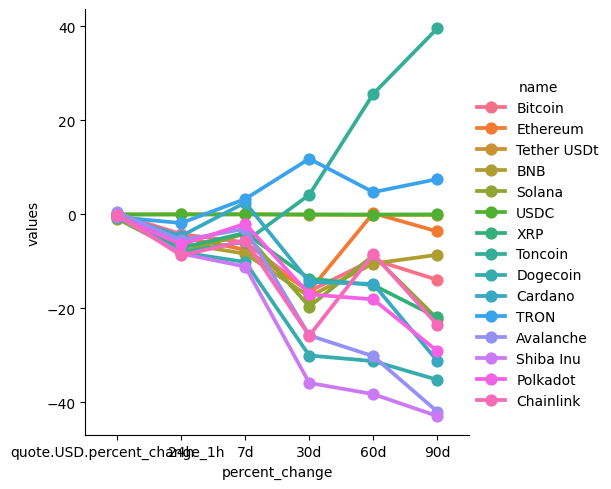

In [51]:
sns.catplot(x='percent_change', y='values', hue='name', data=df7, kind='point')

In [53]:
df10 = df[['name','quote.USD.price','Timestamp']]
df10 = df10.query("name == 'Bitcoin'")
df10

,name,quote.USD.price,Timestamp
0,Bitcoin,57550.24860,2024-07-04 10:31:03.062890
0,Bitcoin,57550.24860,2024-07-04 10:31:03.062890


<Axes: xlabel='Timestamp', ylabel='quote.USD.price'>

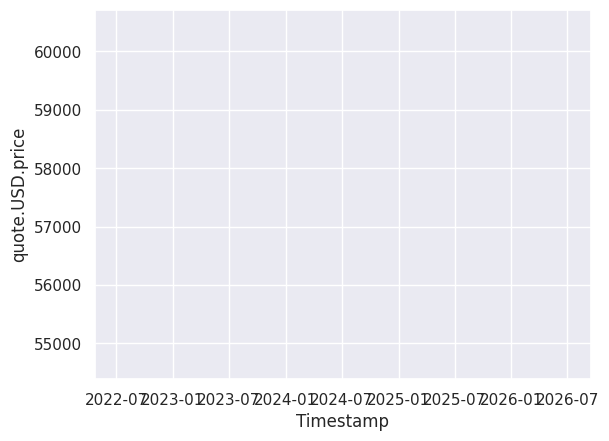

In [57]:
sns.set_theme(style="darkgrid")

sns.lineplot(x='Timestamp', y='quote.USD.price', data = df10)